In [ ]:
import torch
from kan import *
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from datetime import datetime, timedelta
from sklearn.linear_model import LinearRegression


In [3]:
def get_timeseries_training_set(data_series:pd.Series, window_size=84, forecast_size=3):
    y = data_series.to_numpy(dtype=np.float64)

    input_seq = []
    output_seq = []

    for i in range(len(y) - window_size - forecast_size + 1):
        input_seq.append(y[i:i + window_size])
        output_seq.append(y[i + window_size:i + window_size + forecast_size])

    # Step 3: Convert to tensors
    train_input = torch.tensor(input_seq, dtype=torch.float32)  # Shape (n, 10)
    train_label = torch.tensor(output_seq, dtype=torch.float32)  # Shape (n, 3)

    # Step 4: Store in a dictionary
    data_dict = {
        'train_input': train_input,
        'train_label': train_label,
        'test_input': train_input,
        'test_label': train_label
    }

    return data_dict

In [4]:
def pretrain_timeseries_model(model, data_series, window_size=84, forcast_size=3, epochs=20):
    dataset = get_timeseries_training_set(data_series, window_size, forcast_size)
    print(f"{dataset['train_input'].dtype}, {dataset['train_label'].dtype}")
    model.fit(dataset, opt="LBFGS", steps=epochs, lamb=0.001)

In [ ]:
def plot_true_and_predicted(true, predicted):
    # Create a plot
    x = np.arange(len(true))
    
    plt.figure(figsize=(10, 6))
    plt.plot(x, true, label='True', color='blue')
    plt.plot(x, predicted, label='Predicted', color='red')

    # Add labels and title
    plt.title('True vs. Predicted')

    # Add a legend
    plt.legend()

    # Show the plot
    plt.show()

In [ ]:
def compression_ratio_plot(predicted: np.ndarray, true: np.ndarray, threshold=0.05, plot=True):
    # Ensure predicted and true are numpy arrays
    predicted = np.array(predicted)
    true = np.array(true)
    
    # Compute standard deviation and error threshold
    std_dev = np.std(true)  
    error_threshold = threshold * std_dev  

    # Compute the condition: error exceeds the threshold percentage of std_dev
    condition = np.abs(predicted - true) > error_threshold  
    
    # Compute the compression ratio
    count_satisfying_condition = np.sum(condition)
    total_count = len(true)
    ratio = total_count / count_satisfying_condition if count_satisfying_condition > 0 else np.inf

    if plot:
        plt.figure(figsize=(8, 5))

        # Indices where condition is NOT met (valid points)
        valid_indices = np.where(~condition)[0]
        
        # Plot valid points with thinner lines and markers
        plt.plot(valid_indices, true[valid_indices], 'bo-', markersize=4, linewidth=1, alpha=0.6, label="True (Valid)")
        plt.plot(valid_indices, predicted[valid_indices], 'ro-', markersize=4, linewidth=1, alpha=0.6, label="Predicted (Valid)")

        # Draw thin vertical dashed lines at points where the condition IS met
        for i in np.where(condition)[0]:  
            plt.plot([i, i], [true[i], predicted[i]], 'k--', alpha=0.5, linewidth=1)

        # Labels and formatting
        plt.xlabel("Index")
        plt.ylabel("Value")
        plt.title("Predicted vs. True Values (Threshold-Exceeding Points Marked)")
        plt.legend()
        plt.grid(True, linewidth=0.3)

        plt.show()

    return ratio


In [ ]:
def fit_predict_plot(data_series:pd.Series, window_size=10, forcast_size=3, verbose=False, epochs=10, train_test_split=0.5):
    data_series = data_series.ffill().bfill()
    train_size = int(len(data_series) * train_test_split)

    # Fit model
    model = KAN(width=[window_size,5,forcast_size], grid=5, k=3, seed=42, device=torch.device('cuda' if torch.cuda.is_available() else 'cpu'))
    dataset = get_timeseries_training_set(data_series.iloc[:train_size], window_size=window_size, forecast_size=forcast_size)
    model.fit(dataset, opt="LBFGS", steps=epochs, lamb=0.001)

    # Predict for incrementing sliding windows
    predictions = []
    for i in tqdm(range(window_size + train_size, len(data_series) - forcast_size + 1, forcast_size), desc="Predicting: "):
        input_tensor = torch.tensor(data_series.iloc[i - window_size: i].to_numpy(dtype=float), dtype=torch.float32).reshape(1, -1)
        
        # Get prediction
        prediction = model(input_tensor)

        # Unsqueeze and append
        predictions.extend(prediction.squeeze(0).detach().numpy())

    # Numpy arrays of true and predicted
    predicted = np.array(predictions)
    true = data_series[window_size + train_size:window_size + train_size + len(predictions)].to_numpy()

    # Output compression ratio
    cr = compression_ratio_plot(predicted, true, plot=verbose)
    print(f"Compression ratio: {cr}")

In [ ]:
# Test using a time series dataset
num_rows = 4000
days = np.arange(num_rows)
amplitude = 0.5
baseline_temp = 0.5
num_harmonics = 20
period = 365
random_walk_step = 0.01

start_date = datetime.today()
dates = [(start_date + timedelta(days=int(day))).date() for day in days]

temperature = baseline_temp + amplitude * np.sin(2 * np.pi * days / period)

data_sine = pd.DataFrame({
    'timestamp': dates,
    'temperature': temperature
})

temperature_fourier = baseline_temp

for n in range(1, num_harmonics + 1):
    temperature_fourier += (amplitude / n) * np.sin(2 * np.pi * n * days / period) + (amplitude / n) * np.cos(2 * np.pi * n * days / period)

data_complex_fourier = pd.DataFrame({
    'timestamp': dates,
    'temperature': temperature_fourier
})

temperature_sawtooth = baseline_temp + amplitude * (days % period) / period

data_sawtooth = pd.DataFrame({
    'timestamp': dates,
    'temperature': temperature_sawtooth
})

temperature_random_walk = baseline_temp + np.cumsum(np.random.randn(num_rows) * random_walk_step)

data_random = pd.DataFrame({
    'timestamp': dates,
    'temperature': temperature_random_walk
})

checkpoint directory created: ./model
saving model version 0.0


| train_loss: 2.01e-02 | test_loss: 2.01e-02 | reg: 5.92e+00 | : 100%|█| 20/20 [00:24<00:00,  1.21s/

saving model version 0.1


Predicting:   0%|          | 0/660 [00:00<?, ?it/s]

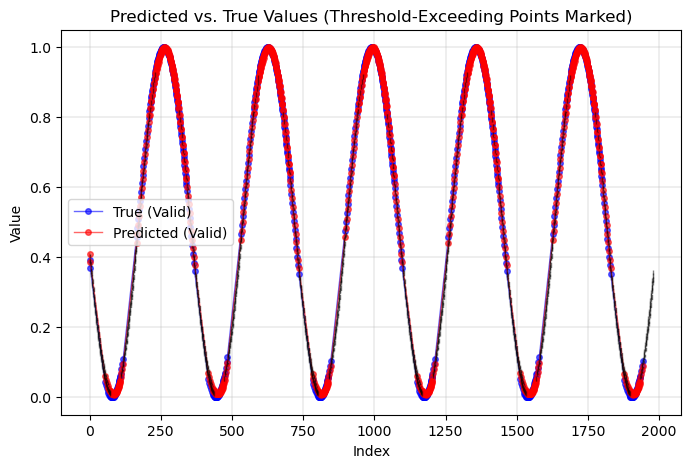

Compression ratio: 1.9859578736208625


In [44]:
fit_predict_plot(data_sine['temperature'], 20, 3, True, 20)

checkpoint directory created: ./model
saving model version 0.0


| train_loss: 4.27e-02 | test_loss: 4.27e-02 | reg: 6.85e+00 | : 100%|█| 20/20 [00:21<00:00,  1.09s/

saving model version 0.1


Predicting:   0%|          | 0/660 [00:00<?, ?it/s]

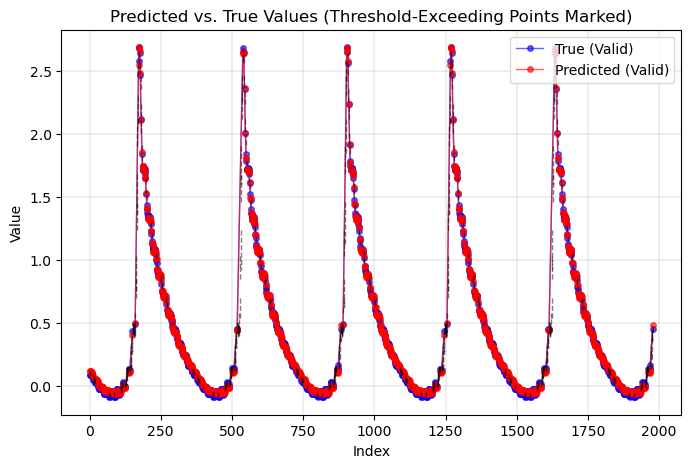

Compression ratio: 4.390243902439025


In [45]:
fit_predict_plot(data_complex_fourier['temperature'], 20, 3, True, 20)

checkpoint directory created: ./model
saving model version 0.0


| train_loss: 3.73e-02 | test_loss: 3.73e-02 | reg: 5.60e+00 | : 100%|█| 20/20 [00:21<00:00,  1.05s/

saving model version 0.1


Predicting:   0%|          | 0/660 [00:00<?, ?it/s]

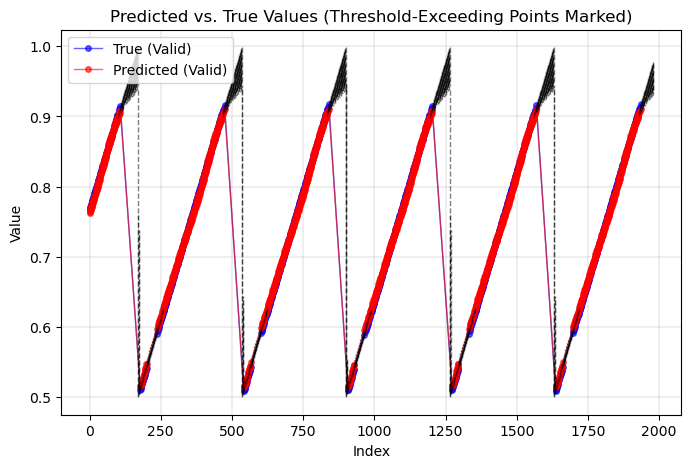

Compression ratio: 3.0045523520485586


In [46]:
fit_predict_plot(data_sawtooth['temperature'], 20, 3, True, 20)

checkpoint directory created: ./model
saving model version 0.0


| train_loss: 1.95e-02 | test_loss: 1.95e-02 | reg: 6.00e+00 | : 100%|█| 20/20 [00:20<00:00,  1.05s/

saving model version 0.1


Predicting:   0%|          | 0/660 [00:00<?, ?it/s]

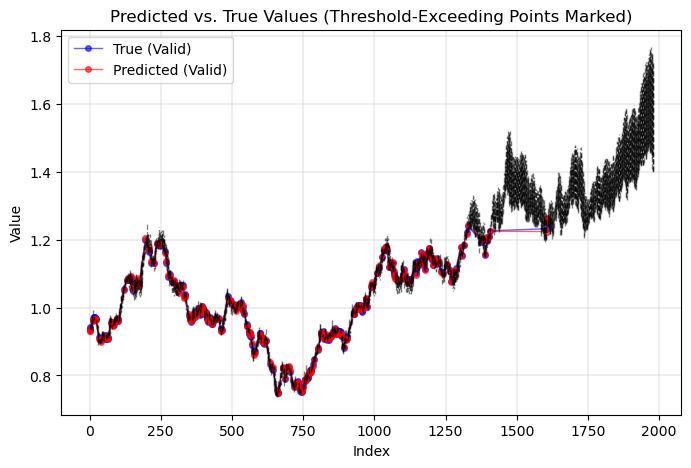

Compression ratio: 1.21996303142329


In [47]:
fit_predict_plot(data_random['temperature'], 20, 3, True, 20)

checkpoint directory created: ./model
saving model version 0.0


| train_loss: 8.53e+01 | test_loss: 8.53e+01 | reg: 3.25e+01 | : 100%|█| 20/20 [01:27<00:00,  4.36s/

saving model version 0.1


Predicting:   0%|          | 0/4956 [00:00<?, ?it/s]

c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:813: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\pytorch\aten\src\ATen\native\ReduceOps.cpp:1831.)
  self.subnode_actscale.append(torch.std(x, dim=0).detach())
c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:823: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\pytorch\aten\src\ATen\native\ReduceOps.cpp:1831.)
  input_range = torch.std(preacts, dim=0) + 0.1
c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:824: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\

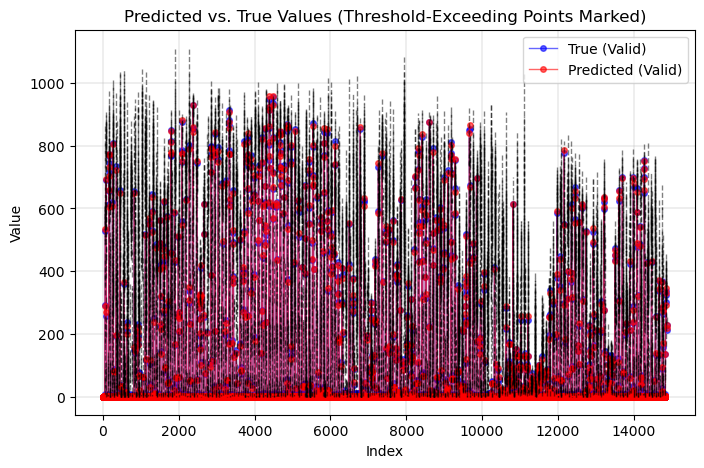

Compression ratio: 2.4031032810732182


In [48]:
csv_path = "ariviyalNagar.csv"
column_1 = "Port 1"

data_df = pd.read_csv(csv_path)

fit_predict_plot(data_df[column_1], 20, 3, True, 20)

checkpoint directory created: ./model
saving model version 0.0


| train_loss: 2.89e+01 | test_loss: 2.89e+01 | reg: 3.28e+01 | : 100%|█| 20/20 [01:35<00:00,  4.79s/

saving model version 0.1


Predicting:   0%|          | 0/4956 [00:00<?, ?it/s]

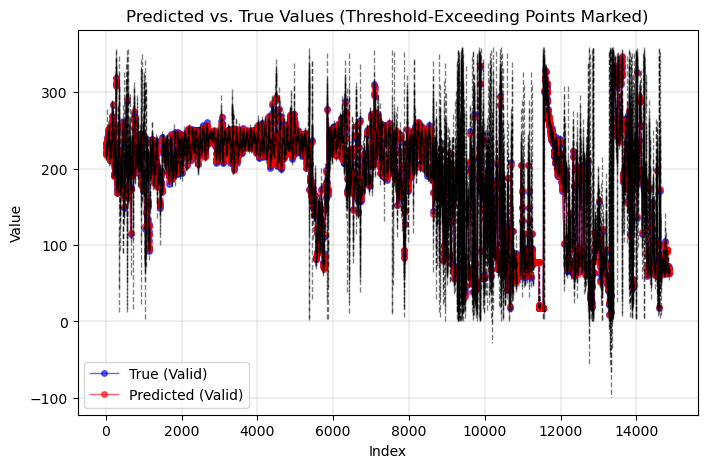

Compression ratio: 1.3647879566733983


In [49]:
column_2 = "Port 1.4"
fit_predict_plot(data_df[column_2], 20, 3, True, 20)

checkpoint directory created: ./model
saving model version 0.0


| train_loss: 4.66e-01 | test_loss: 4.66e-01 | reg: 2.33e+01 | : 100%|█| 20/20 [01:35<00:00,  4.79s/

saving model version 0.1


Predicting:   0%|          | 0/4956 [00:00<?, ?it/s]

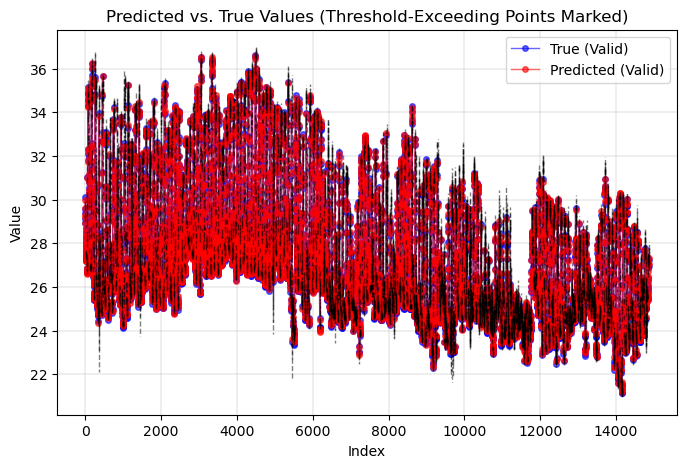

Compression ratio: 1.7622377622377623


In [50]:
column_3 = "Port 1.7"
fit_predict_plot(data_df[column_3], 20, 3, True, 20)

checkpoint directory created: ./model
saving model version 0.0


| train_loss: 1.25e-01 | test_loss: 1.25e-01 | reg: 2.57e+01 | : 100%|█| 20/20 [01:37<00:00,  4.85s/

saving model version 0.1


Predicting:   0%|          | 0/4956 [00:00<?, ?it/s]

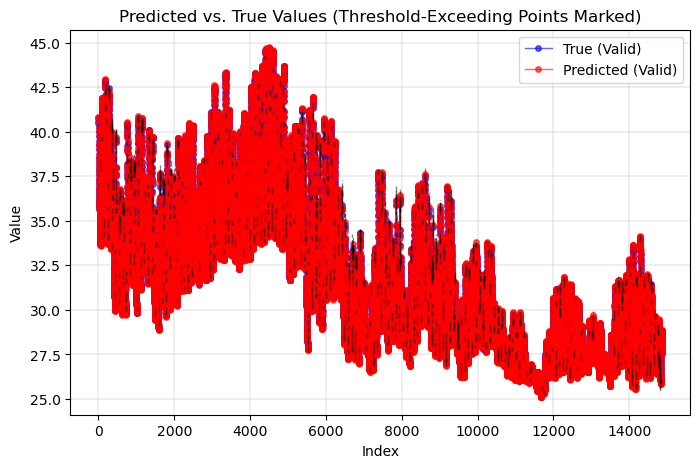

Compression ratio: 9.464035646085296


In [51]:
column_4 = "Port 2.1"
fit_predict_plot(data_df[column_4], 20, 3, True, 20)

In [ ]:
def fit_predict_plot_sync_all(data_series: pd.Series, window_size=10, forecast_size=3, verbose=False, epochs=10, train_test_split=0.5):
    data_series = data_series.ffill().bfill()
    train_size = int(len(data_series) * train_test_split)

    # Fit model
    model = KAN(width=[window_size, 5, forecast_size], grid=5, k=3, seed=42,
                device=torch.device('cuda' if torch.cuda.is_available() else 'cpu'))
    dataset = get_timeseries_training_set(data_series.iloc[:train_size], window_size=window_size, forecast_size=forecast_size)
    model.fit(dataset, opt="LBFGS", steps=epochs, lamb=0.001)

    # Predict for incrementing sliding windows
    predictions = []
    for i in tqdm(range(window_size + train_size, len(data_series) - forecast_size + 1, forecast_size), desc="Predicting: "):
        # Extract the sliding window
        original_window = data_series.iloc[i - window_size: i].to_numpy(dtype=float)

        # Fit a line y = mx + c
        x = np.arange(len(original_window)).reshape(-1, 1)
        y = original_window.reshape(-1, 1)
        reg = LinearRegression().fit(x, y)
        m, c = reg.coef_[0, 0], reg.intercept_[0]

        # Generate a new sliding window using the fitted line
        new_window = np.array([m * x_i + c for x_i in range(window_size)], dtype=float)

        # Convert to tensor and reshape
        input_tensor = torch.tensor(new_window, dtype=torch.float32).reshape(1, -1)

        # Get prediction
        prediction = model(input_tensor)

        # Unsqueeze and append
        predictions.extend(prediction.squeeze(0).detach().numpy())

    # Convert to numpy arrays
    predicted = np.array(predictions)
    true = data_series[window_size + train_size:window_size + train_size + len(predictions)].to_numpy()

    # Output compression ratio
    cr = compression_ratio_plot(predicted, true, plot=verbose)
    print(f"Compression ratio: {cr}")

checkpoint directory created: ./model
saving model version 0.0


| train_loss: 2.08e-02 | test_loss: 2.08e-02 | reg: 5.86e+00 | : 100%|█| 20/20 [00:20<00:00,  1.02s/

saving model version 0.1


Predicting:   0%|          | 0/660 [00:00<?, ?it/s]

c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:813: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\pytorch\aten\src\ATen\native\ReduceOps.cpp:1831.)
  self.subnode_actscale.append(torch.std(x, dim=0).detach())
c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:823: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\pytorch\aten\src\ATen\native\ReduceOps.cpp:1831.)
  input_range = torch.std(preacts, dim=0) + 0.1
c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:824: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\

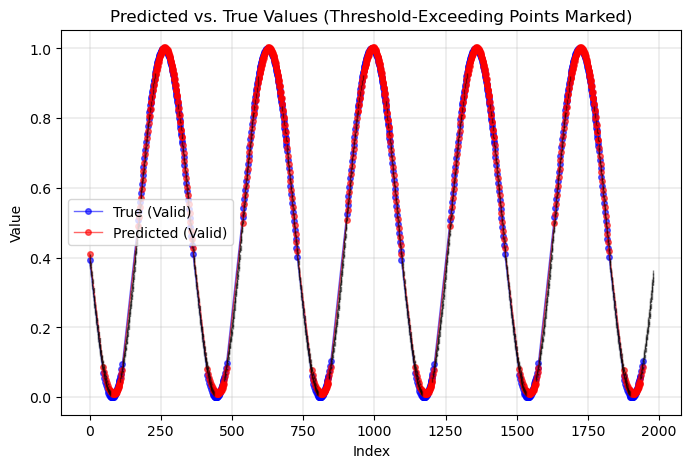

Compression ratio: 1.892925430210325


In [53]:
fit_predict_plot_sync_all(data_sine['temperature'], 20, 3, True, 20)

checkpoint directory created: ./model
saving model version 0.0


| train_loss: 4.26e-02 | test_loss: 4.26e-02 | reg: 6.84e+00 | : 100%|█| 20/20 [00:19<00:00,  1.01it

saving model version 0.1


Predicting:   0%|          | 0/660 [00:00<?, ?it/s]

c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:813: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\pytorch\aten\src\ATen\native\ReduceOps.cpp:1831.)
  self.subnode_actscale.append(torch.std(x, dim=0).detach())
c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:823: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\pytorch\aten\src\ATen\native\ReduceOps.cpp:1831.)
  input_range = torch.std(preacts, dim=0) + 0.1
c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:824: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\

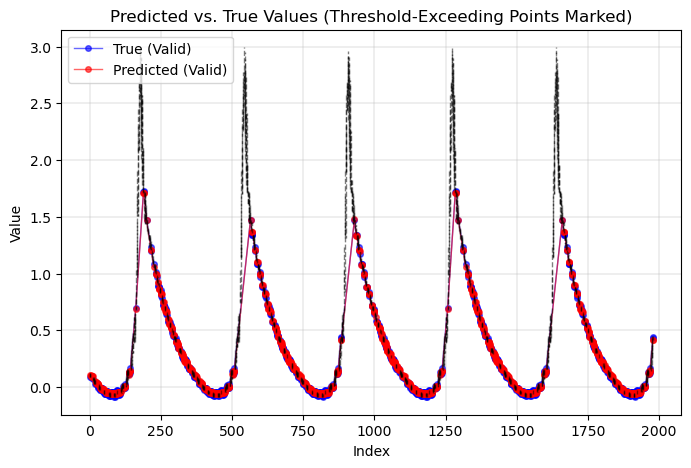

Compression ratio: 2.1806167400881056


In [54]:
fit_predict_plot_sync_all(data_complex_fourier['temperature'], 20, 3, True, 20)

checkpoint directory created: ./model
saving model version 0.0


| train_loss: 3.80e-02 | test_loss: 3.80e-02 | reg: 5.72e+00 | : 100%|█| 20/20 [00:20<00:00,  1.01s/

saving model version 0.1


Predicting:   0%|          | 0/660 [00:00<?, ?it/s]

c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:813: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\pytorch\aten\src\ATen\native\ReduceOps.cpp:1831.)
  self.subnode_actscale.append(torch.std(x, dim=0).detach())
c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:823: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\pytorch\aten\src\ATen\native\ReduceOps.cpp:1831.)
  input_range = torch.std(preacts, dim=0) + 0.1
c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:824: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\

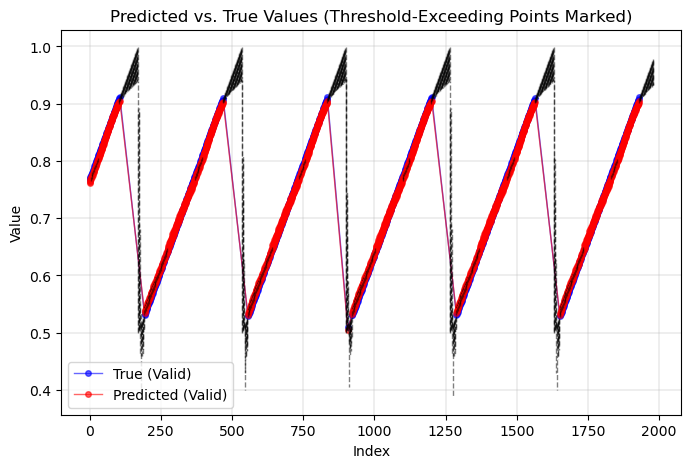

Compression ratio: 2.933333333333333


In [55]:
fit_predict_plot_sync_all(data_sawtooth['temperature'], 20, 3, True, 20)

checkpoint directory created: ./model
saving model version 0.0


| train_loss: 1.84e-02 | test_loss: 1.84e-02 | reg: 5.76e+00 | : 100%|█| 20/20 [00:23<00:00,  1.19s/

saving model version 0.1


Predicting:   0%|          | 0/660 [00:00<?, ?it/s]

c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:813: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\pytorch\aten\src\ATen\native\ReduceOps.cpp:1831.)
  self.subnode_actscale.append(torch.std(x, dim=0).detach())
c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:823: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\pytorch\aten\src\ATen\native\ReduceOps.cpp:1831.)
  input_range = torch.std(preacts, dim=0) + 0.1
c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:824: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\

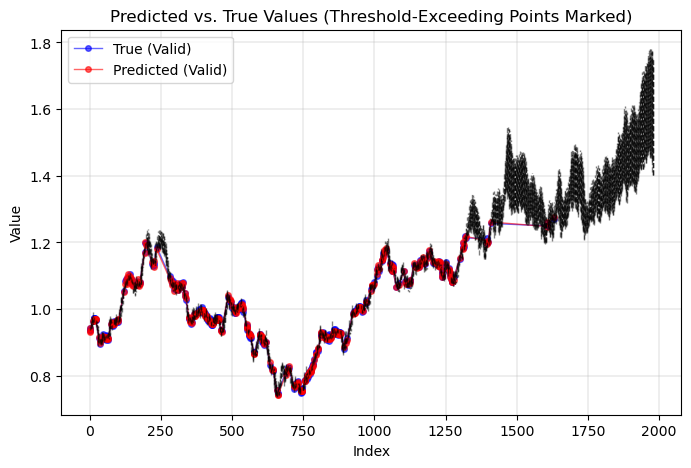

Compression ratio: 1.2421580928481806


In [56]:
fit_predict_plot_sync_all(data_random['temperature'], 20, 3, True, 20)

checkpoint directory created: ./model
saving model version 0.0


| train_loss: 8.53e+01 | test_loss: 8.53e+01 | reg: 3.49e+01 | : 100%|█| 20/20 [01:47<00:00,  5.40s/

saving model version 0.1


Predicting:   0%|          | 0/4956 [00:00<?, ?it/s]

c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:813: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\pytorch\aten\src\ATen\native\ReduceOps.cpp:1831.)
  self.subnode_actscale.append(torch.std(x, dim=0).detach())
c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:823: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\pytorch\aten\src\ATen\native\ReduceOps.cpp:1831.)
  input_range = torch.std(preacts, dim=0) + 0.1
c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:824: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\

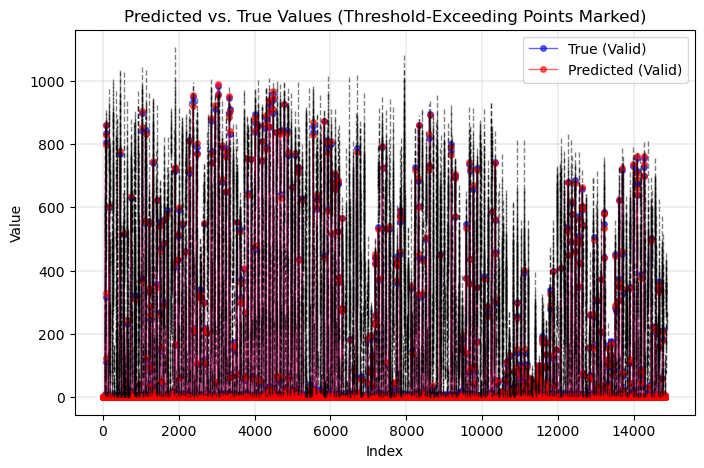

Compression ratio: 2.275482093663912


In [57]:
csv_path = "ariviyalNagar.csv"
column_1 = "Port 1"

data_df = pd.read_csv(csv_path)

fit_predict_plot_sync_all(data_df[column_1], 20, 3, True, 20)

checkpoint directory created: ./model
saving model version 0.0


| train_loss: 2.91e+01 | test_loss: 2.91e+01 | reg: 2.87e+01 | : 100%|█| 20/20 [01:33<00:00,  4.69s/

saving model version 0.1


Predicting:   0%|          | 0/4956 [00:00<?, ?it/s]

c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:813: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\pytorch\aten\src\ATen\native\ReduceOps.cpp:1831.)
  self.subnode_actscale.append(torch.std(x, dim=0).detach())
c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:823: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\pytorch\aten\src\ATen\native\ReduceOps.cpp:1831.)
  input_range = torch.std(preacts, dim=0) + 0.1
c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:824: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\

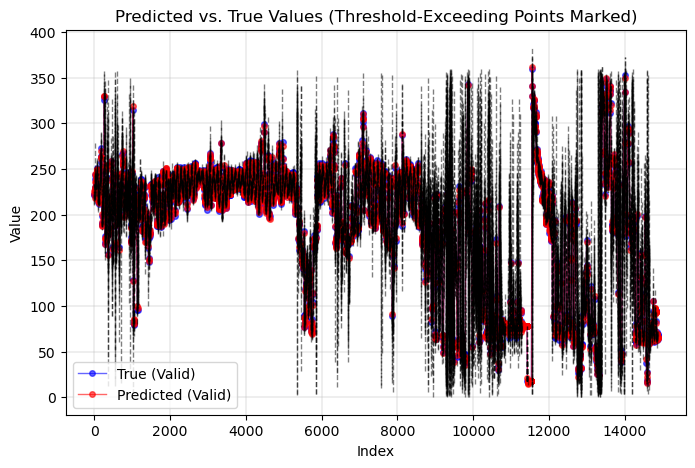

Compression ratio: 1.302154492905938


In [58]:
column_2 = "Port 1.4"
fit_predict_plot_sync_all(data_df[column_2], 20, 3, True, 20)

checkpoint directory created: ./model
saving model version 0.0


| train_loss: 4.71e-01 | test_loss: 4.71e-01 | reg: 2.48e+01 | : 100%|█| 20/20 [01:36<00:00,  4.81s/

saving model version 0.1


Predicting:   0%|          | 0/4956 [00:00<?, ?it/s]

c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:813: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\pytorch\aten\src\ATen\native\ReduceOps.cpp:1831.)
  self.subnode_actscale.append(torch.std(x, dim=0).detach())
c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:823: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\pytorch\aten\src\ATen\native\ReduceOps.cpp:1831.)
  input_range = torch.std(preacts, dim=0) + 0.1
c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:824: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\

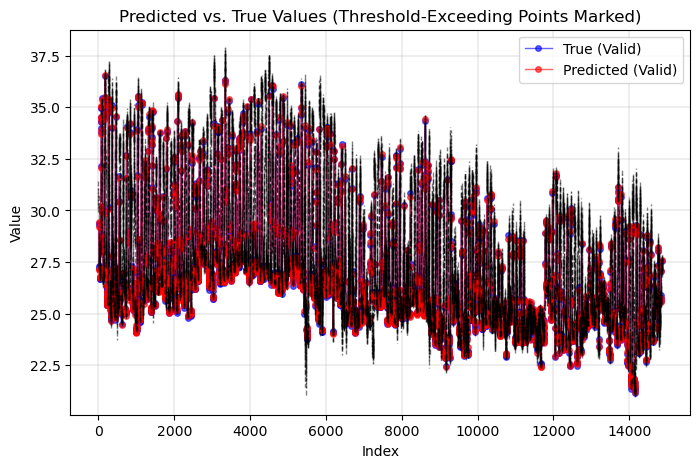

Compression ratio: 1.2737085582112568


In [59]:
column_3 = "Port 1.7"
fit_predict_plot_sync_all(data_df[column_3], 20, 3, True, 20)

checkpoint directory created: ./model
saving model version 0.0


| train_loss: 1.24e-01 | test_loss: 1.24e-01 | reg: 2.59e+01 | : 100%|█| 20/20 [01:48<00:00,  5.44s/

saving model version 0.1


Predicting:   0%|          | 0/4956 [00:00<?, ?it/s]

c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:813: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\pytorch\aten\src\ATen\native\ReduceOps.cpp:1831.)
  self.subnode_actscale.append(torch.std(x, dim=0).detach())
c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:823: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\pytorch\aten\src\ATen\native\ReduceOps.cpp:1831.)
  input_range = torch.std(preacts, dim=0) + 0.1
c:\Users\atlee\anaconda3\Lib\site-packages\kan\MultKAN.py:824: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\

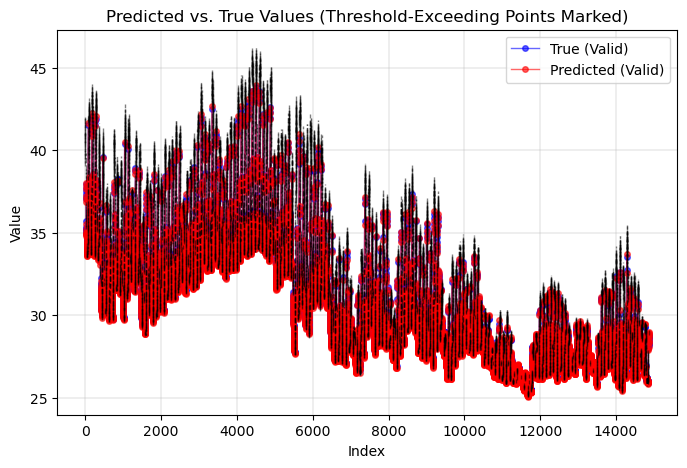

Compression ratio: 2.0355969331872945


In [60]:
column_4 = "Port 2.1"
fit_predict_plot_sync_all(data_df[column_4], 20, 3, True, 20)